# Tarea 2

**MDS7202: Laboratorio de Programación Científica para Ciencia de Datos**

*Por favor, lean detalladamente las instrucciones de la tarea antes de empezar a escribir.*


----

## Información General

El objetivo de esta tarea es sencilla: Nosotros les propondremos algunos problemas (obtenidas desde [Kaggle](https://www.kaggle.com/)), **ustedes eligen uno y luego lo resuelven con las metodologías y herramientas que hemos visto con el curso.** Si no les gusta ninguno de los problemas o creen que son muy sencillos y desean proponer un problema personalizado, ¡no lo duden consultarlo con el equipo docente!

La idea de *Kaggle* es compartir datasets y problemas para que la gente o equipos los puedan resolver. Comunmente las personas que resuelven los problemas suben su notebook con las respuestas.
Como hemos dicho anteriormente, la copia está prohibida, sin embargo, pueden inspirarse en los notebooks que ahí se encuentren. Recuerden que la idea es que aprendan 😉.

## Reglas

- Fecha de entrega: 19/07/2021
- **Grupos de 2 personas.**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Estrictamente prohibida la copia. 
- Pueden usar cualquier material del curso que estimen conveniente.



# Tarea 2 - Learning from Imbalanced Insurance Data

### Equipo:

- Joaquín Ortega
- María José Zambrano

### Link de repositorio de GitHub: https://github.com/mzambrano1/Lab-programacion-cientifica




## 1. Introducción

El problema que escogimos es el 'Learning from Imbalanced Insurance Data' Su objetivo consiste en predecir el interés de un potencial cliente en comprar un seguro de automovil.

Los datos que proveen es un dataset con 382154 ejemplos que describen características de personas tanto de índole demográfica (edad, género) como orientadas a la variable objetivo (si contrató anteriormente, si hay daño en su auto, años del auto, etc.).

Son 11 atributos y la variable de predicción es binaria (1 si está interesado en comprar, 0 en caso contrario).

La tarea se evalua en base a la métrica AUC ya que es un buen indicador de qué tan bien el modelo separa las clases (ya que está basado en la curva ROC, la cual contrasta sensitividad vs 1-especificidad). El AUC es sensible ante el desbalance, a diferencia del Accuracy que suele aumentar ante un desbalance (pues naturalmente los verdaderos positivos aumentan). 

La propuesta para resolver el problema consistió en un modelo basado en árboles de decisión (RandomForest y ExtraTreesClassifier).

El modelo final cumplió parcialmente con el objetivo de predecir con alta performance la variable objetivo, puesto que los resultados si bien no fueron malos, aún pueden mejorarse si se tuviesen más recursos para evaluar distintos modelos.

---
## 2. Análisis Exploratorio de Datos

In [ ]:
!pip install pycaret

     |████████████████████████████████| 266kB 8.0MB/s 
     |████████████████████████████████| 1.7MB 15.0MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 61kB 7.0MB/s 
     |████████████████████████████████| 174kB 42.6MB/s 
     |████████████████████████████████| 256kB 41.4MB/s 
     |████████████████████████████████| 1.4MB 30.4MB/s 
     |████████████████████████████████| 2.0MB 35.8MB/s 
     |████████████████████████████████| 276kB 36.2MB/s 
     |████████████████████████████████| 6.8MB 35.9MB/s 
     |████████████████████████████████| 112kB 43.5MB/s 
     |████████████████████████████████| 81kB 8.7MB/s 
     |████████████████████████████████| 14.4MB 216kB/s 
     |████████████████████████████████| 10.1MB 33.5MB/s 
     |████████████████████████████████| 645kB 30.6MB/s 
     |████████████████████████████████| 1.1MB 25.4M

In [1]:
try:
    from google.colab import drive
    drive.mount("/content/drive")
    path = '/content/drive/My Drive/Lab T2/'
except ModuleNotFoundError:
    import os
    path = os.getcwd()

Mounted at /content/drive


In [5]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from pycaret.datasets import get_data
from pycaret.classification import *

import plotly.express as px
from sklearn.decomposition import PCA

from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.pipeline import Pipeline

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, cohen_kappa_score, recall_score, precision_score

from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler 
from sklearn.model_selection import train_test_split 

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning:

The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.



In [7]:
df = pd.read_csv(path + './aug_train.csv')

In [ ]:
df.shape

(382154, 12)

In [ ]:
df.head(2)

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,167647,Male,22,1,7.0,1,< 1 Year,No,2630.0,152.0,16,0
1,17163,Male,42,1,28.0,0,1-2 Year,Yes,43327.0,26.0,135,0


In [ ]:
df.describe()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000
mean,234392.953477,38.545691,0.998108,26.406867,0.489182,30711.271362,111.939812,154.189429,0.163811
std,139527.487326,15.226897,0.043455,13.181241,0.499884,17061.595532,54.286511,83.735107,0.370104
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,115006.250000,25.000000,1.000000,15.000000,0.000000,24546.000000,26.000000,81.000000,0.000000
50%,230461.500000,36.000000,1.000000,28.000000,0.000000,31692.000000,145.000000,154.000000,0.000000
75%,345434.750000,49.000000,1.000000,35.000000,1.000000,39447.750000,152.000000,227.000000,0.000000
max,508145.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


In [ ]:
df.isna().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64

In [ ]:
df['Gender'].value_counts()

Male      205603
Female    176551
Name: Gender, dtype: int64

In [ ]:
gender = df['Gender'].value_counts()
fig = px.pie(values=gender.values, names=gender.index)
fig.show()

In [ ]:
response = df['Response'].value_counts()
fig = px.pie(values=response.values, names=response.index)
fig.show()

In [10]:
dl = df['Driving_License'].value_counts()
fig = px.pie(values=dl.values, names=dl.index,color_discrete_sequence=[px.colors.qualitative.Plotly[1],px.colors.qualitative.Plotly[0]])
fig.show()

In [ ]:
pi = df['Previously_Insured'].value_counts()
fig = px.pie(values=pi.values, names=pi.index)
fig.show()

In [ ]:
vd = df['Vehicle_Damage'].value_counts()
fig = px.pie(values=vd.values, names=vd.index)
fig.show()

In [ ]:
fig = px.histogram(df, x ='Age')
fig.show()

In [ ]:
fig = px.histogram(df, x ='Vehicle_Age')
fig.show()

In [ ]:
fig = px.histogram(df, x ='Annual_Premium') 
fig.show()

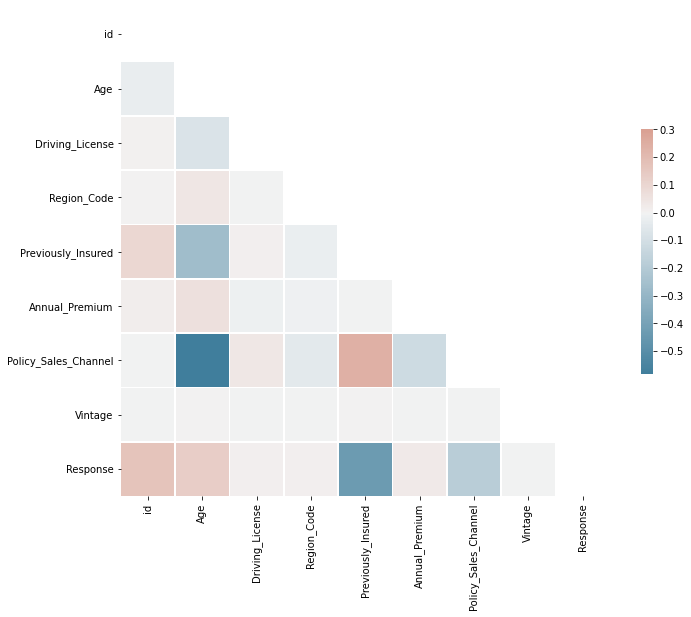

In [ ]:
corr =  df.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

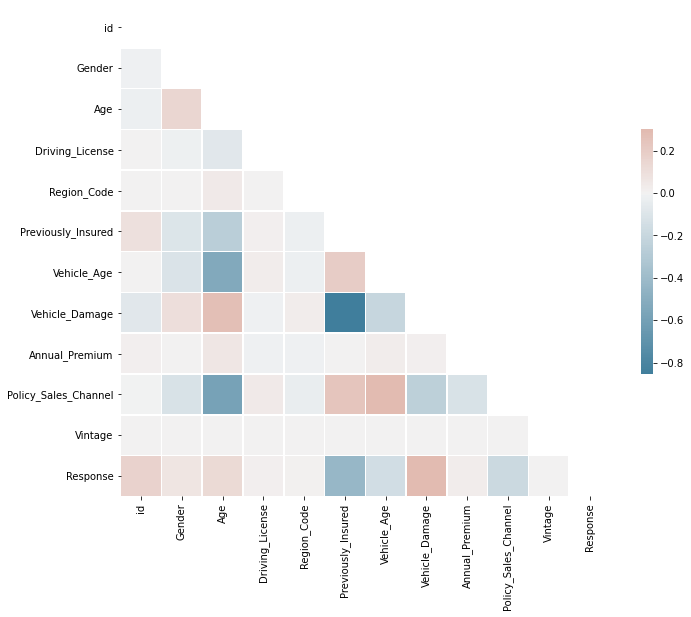

In [ ]:
df_2 = df.copy()

df_2.Vehicle_Age=df_2.Vehicle_Age.astype('category').cat.codes
df_2.Gender=df_2.Gender.astype('category').cat.codes
df_2.Vehicle_Damage=df_2.Vehicle_Damage.astype('category').cat.codes


corr =  df_2.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [ ]:
abs(corr['Response']).sort_values()

Vintage                 0.001884
Region_Code             0.011289
Driving_License         0.013250
Annual_Premium          0.030777
Gender                  0.066895
Age                     0.133149
Vehicle_Age             0.150993
id                      0.166621
Policy_Sales_Channel    0.184514
Previously_Insured      0.431224
Vehicle_Damage          0.448661
Response                1.000000
Name: Response, dtype: float64

In [ ]:
fig = px.pie(df[df['Vehicle_Damage']=='Yes'], 'Previously_Insured' )
fig.show()
print(df[df['Vehicle_Damage']=='Yes'].shape)

(183653, 12)


In [11]:
fig = px.pie(df[df['Vehicle_Damage']=='No'], 'Previously_Insured',color_discrete_sequence=[px.colors.qualitative.Plotly[1],px.colors.qualitative.Plotly[0]] )
fig.show()
print(df[df['Vehicle_Damage']=='No'].shape)

(198501, 12)


In [ ]:
df[df.duplicated()]

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response


In [ ]:
df.describe()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000
mean,234392.953477,38.545691,0.998108,26.406867,0.489182,30711.271362,111.939812,154.189429,0.163811
std,139527.487326,15.226897,0.043455,13.181241,0.499884,17061.595532,54.286511,83.735107,0.370104
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,115006.250000,25.000000,1.000000,15.000000,0.000000,24546.000000,26.000000,81.000000,0.000000
50%,230461.500000,36.000000,1.000000,28.000000,0.000000,31692.000000,145.000000,154.000000,0.000000
75%,345434.750000,49.000000,1.000000,35.000000,1.000000,39447.750000,152.000000,227.000000,0.000000
max,508145.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


In [ ]:
px.violin(df, y='Age', x='Previously_Insured')

In [ ]:
px.histogram(df, x='Region_Code')

In [ ]:
px.histogram(df, x='Vintage')

In [ ]:
df_2.columns

Index(['id', 'Gender', 'Age', 'Driving_License', 'Region_Code',
       'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium',
       'Policy_Sales_Channel', 'Vintage', 'Response'],
      dtype='object')

In [ ]:


X = df_2.drop(columns=['id', 'Gender', 'Policy_Sales_Channel']) 

pca = PCA(n_components=2)
components = pca.fit_transform(X)

fig = px.scatter(components, x=0, y=1, color=df_2['Response'])
fig.show()


Al efectuar el análisis exploratorio de datos pudimos notar lo siguiente:

No hay filas duplicadas, tampoco hay valores NaN. Ante los gráficos de círculo e histogramas, se pueden observar un fuerte desbalance en la variable objetivo, lo que dificulta el análisis. Además, se puede observar que los datos están orientados a un público mayoritariamente joven y conductor (esto último por razones lógicas), de hecho, más de 99% de las personas tienen licencia, por lo que se eliminará a quienes no poseen (se dejará como requisito excluyente).


Hay tres variables categóricas: Gender, Vehicle_Damage, Vehicle_Age.

La distribución de los datos numéricos no es clara (i.e. no siguen una tendencia fácilmente identificable).

Los atributos de Vehicle_Damage y Previously_Insured están negativamente correlacionados, esto es, cuando hay daño en el vehículo, este no ha sido asegurado antes, y viceversa.

Con respecto a la variable objetivo, se puede ver que las variables de mayor correlación son Vehicle_Damage y Previously_Insured, las cuales también están altamente correlacionadas entre sí, por lo que hay que tener esto en consideración al generar modelos estadísticos.

Además, encontramos que al proyectar en 2D no se visualiza nada concluyente, probablemente debido al mismo desbalance del dataset.




---

## 3. Preparación de Datos

Para preparar nuestros datos, primero eliminamos duplicados y outliers...:

Como no hay duplicados ni datos nulos, no es necesario realizar algo al respecto con los datos.

Por lo que la preparación realizada consiste en eliminar los outliers en la columna "Anual_premium", que es la única que mostraba outliers claros.

Además se eliminan todas las personas que no tienen licencia de conducir, ya que pueden se consideradas outliers, corresponden a menos del 1% del total de datos y no es común que una persona que no tiene licencia contrate un seguro de auto.

In [ ]:
dc = df.describe()
dc

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000,382154.000000
mean,234392.953477,38.545691,0.998108,26.406867,0.489182,30711.271362,111.939812,154.189429,0.163811
std,139527.487326,15.226897,0.043455,13.181241,0.499884,17061.595532,54.286511,83.735107,0.370104
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,115006.250000,25.000000,1.000000,15.000000,0.000000,24546.000000,26.000000,81.000000,0.000000
50%,230461.500000,36.000000,1.000000,28.000000,0.000000,31692.000000,145.000000,154.000000,0.000000
75%,345434.750000,49.000000,1.000000,35.000000,1.000000,39447.750000,152.000000,227.000000,0.000000
max,508145.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


In [ ]:
Q1 = dc.iloc()[4,:]
Q3 = dc.iloc()[6,:]
IQR = Q3-Q1

c_i = Q1-1.5*IQR
C_S = Q3+1.5*IQR

df = df[(df['Annual_Premium']<C_S[5])] #Se eliminan outliers de anual premium
df = df[df['Annual_Premium']>c_i[5]]


In [ ]:
df

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,167647,Male,22,1,7.0,1,< 1 Year,No,2630.0,152.0,16,0
1,17163,Male,42,1,28.0,0,1-2 Year,Yes,43327.0,26.0,135,0
2,32023,Female,66,1,33.0,0,1-2 Year,Yes,35841.0,124.0,253,0
3,87447,Female,22,1,33.0,0,< 1 Year,No,27645.0,152.0,69,0
4,501933,Male,28,1,46.0,1,< 1 Year,No,29023.0,152.0,211,0
...,...,...,...,...,...,...,...,...,...,...,...,...
382148,89317,Male,47,1,43.0,0,1-2 Year,Yes,32774.0,124.0,105,0
382149,164549,Male,24,1,15.0,0,< 1 Year,Yes,23938.0,152.0,105,0
382151,165293,Male,45,1,28.0,0,1-2 Year,Yes,40443.0,26.0,187,0
382152,383241,Female,28,1,28.0,1,< 1 Year,No,25380.0,152.0,208,0


In [ ]:
df.describe()

,id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,371747.000000,371747.000000,371747.000000,371747.000000,371747.000000,371747.00000,371747.000000,371747.000000,371747.000000
mean,234391.643908,38.399654,0.998165,26.457303,0.490775,29413.88189,112.436014,154.194495,0.162812
std,139566.760183,15.154544,0.042793,13.259608,0.499916,14612.83127,54.126822,83.733577,0.369195
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.00000,1.000000,10.000000,0.000000
25%,114916.500000,25.000000,1.000000,15.000000,0.000000,24270.00000,29.000000,82.000000,0.000000
50%,230430.000000,36.000000,1.000000,28.000000,0.000000,31339.00000,151.000000,154.000000,0.000000
75%,345504.500000,49.000000,1.000000,36.000000,1.000000,38637.00000,152.000000,227.000000,0.000000
max,508144.000000,85.000000,1.000000,52.000000,1.000000,61800.00000,163.000000,299.000000,1.000000


In [ ]:
df = df[df['Driving_License'] == 1] # se dejan solo las peronas con liciencia

In [ ]:
df

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,167647,Male,22,1,7.0,1,< 1 Year,No,2630.0,152.0,16,0
1,17163,Male,42,1,28.0,0,1-2 Year,Yes,43327.0,26.0,135,0
2,32023,Female,66,1,33.0,0,1-2 Year,Yes,35841.0,124.0,253,0
3,87447,Female,22,1,33.0,0,< 1 Year,No,27645.0,152.0,69,0
4,501933,Male,28,1,46.0,1,< 1 Year,No,29023.0,152.0,211,0
...,...,...,...,...,...,...,...,...,...,...,...,...
382148,89317,Male,47,1,43.0,0,1-2 Year,Yes,32774.0,124.0,105,0
382149,164549,Male,24,1,15.0,0,< 1 Year,Yes,23938.0,152.0,105,0
382151,165293,Male,45,1,28.0,0,1-2 Year,Yes,40443.0,26.0,187,0
382152,383241,Female,28,1,28.0,1,< 1 Year,No,25380.0,152.0,208,0


Luego, preparamos un `ColumnTransformer` que prepara los datos:

In [ ]:
df.columns

Index(['id', 'Gender', 'Age', 'Driving_License', 'Region_Code',
       'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium',
       'Policy_Sales_Channel', 'Vintage', 'Response'],
      dtype='object')

In [ ]:

num_vars = ['Age', 'Annual_Premium', 'Vintage', 'Policy_Sales_Channel']

car_vars = ['Gender', 'Vehicle_Age', 'Vehicle_Damage', 'Previously_Insured']

preprocessing_transformer = ColumnTransformer(transformers=[('scaler',StandardScaler(), num_vars),
                                                            ('catscaler', OneHotEncoder() , car_vars)])




---

## 4. Baseline

Adjuntamos las transformaciones anteriores en un solo `Pipeline` y agregamos al final un clasificador sencillo `Random Forest'

En primer lugar se entrena un Random Forest, buscando con gridsearch el mejor criterion.

In [ ]:
pipeline = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', RandomForestClassifier())])

y luego lo entrenamos usando `GridSearchCV`

In [ ]:
pipeline.get_params()

{'Preprocessing': ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
                   transformer_weights=None,
                   transformers=[('scaler',
                                  StandardScaler(copy=True, with_mean=True,
                                                 with_std=True),
                                  ['Age', 'Annual_Premium', 'Vintage',
                                   'Policy_Sales_Channel']),
                                 ('catscaler',
                                  OneHotEncoder(categories='auto', drop=None,
                                                dtype=<class 'numpy.float64'>,
                                                handle_unknown='error',
                                                sparse=True),
                                  ['Gender', 'Vehicle_Age', 'Vehicle_Damage',
                                   'Previously_Insured'])],
                   verbose=False),
 'Preprocessing__catscaler': OneHotEnc

In [ ]:

params = {
    'clf__criterion':['gini', 'entropy']
}

gs = GridSearchCV(pipeline, param_grid = params, scoring= {'AUC':make_scorer(roc_auc_score), 'Accuracy':make_scorer(accuracy_score), 'F1': make_scorer(f1_score), 'kappa': make_scorer(cohen_kappa_score), 'recall': make_scorer(recall_score) }, refit='AUC')

In [ ]:
gs.fit(df, df['Response'])

GridSearchCV(cv=None, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('Preprocessing',
                                        ColumnTransformer(n_jobs=None,
                                                          remainder='drop',
                                                          sparse_threshold=0.3,
                                                          transformer_weights=None,
                                                          transformers=[('scaler',
                                                                         StandardScaler(copy=True,
                                                                                        with_mean=True,
                                                                                        with_std=True),
                                                                         ['Age',
                                                                          'An

In [ ]:
gs.best_params_

{'clf__criterion': 'entropy'}

In [ ]:
gs.best_score_

0.657619111778941

In [ ]:
pipeline = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', RandomForestClassifier(criterion='entropy'))])

X,y = df, df['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 1,stratify=y)

pipeline.fit(X_train, y_train)

Pipeline(steps=[('Preprocessing',
                 ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                                  ['Age', 'Annual_Premium',
                                                   'Vintage',
                                                   'Policy_Sales_Channel']),
                                                 ('catscaler', OneHotEncoder(),
                                                  ['Gender', 'Vehicle_Age',
                                                   'Vehicle_Damage',
                                                   'Previously_Insured'])])),
                ('clf', RandomForestClassifier(criterion='entropy'))])

In [ ]:
y_pred = pipeline.predict(X_test)

In [ ]:
print(
    f'ACCURACY: {accuracy_score(y_test, y_pred)}',
    f'\nAUC ROC: {roc_auc_score(y_test, y_pred)}',
    f'\nF1_Score: {f1_score(y_test, y_pred)}',
    f'\nKappa: {cohen_kappa_score(y_test, y_pred)}', 
    f'\nRecall: {recall_score(y_test, y_pred)}',
    f'\nPrecision: {precision_score(y_test, y_pred)}'
)

ACCURACY: 0.8322571604126467 
AUC ROC: 0.6557239817931251 
F1_Score: 0.43354810527465326 
Kappa: 0.33627541073308187 
Recall: 0.39379711678349427 
Precision: 0.4822252813993036


Al entrenar el pipeline se obtiene una alta accuracy, lo cual puede resultar engañoso debido al gran desbalance. Una mejor métrica puede ser el AUC y el F1, los cuales dejan bastante que desear. A continuación se tratará el desbalance y se explorarán más opciones en el gridsearchCV. Junto con un análisis de clasificadores mediante la librería PyCaret.

---

## 5. Optimización del Modelo

Ahora, agregamos selección y/o reducción de atributos y probaremos una combinación de diferentes parámetros para mejorar nuestro modelo:


*Nota*: Procuren hacer Gridsearch sobre espacios de búsqueda razonables. Es decir, no estén 3 días buscando la mejor configuración...

Lo primero que se realiza para mejorar el rendimiento es el balance de los datos con un oversampling

In [ ]:
#Balance de datos
X,y = df, df['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 1,stratify=y)

X_train = X_train 
over = RandomOverSampler(random_state=42)
X_train, y_train = over.fit_resample(X_train, y_train)
X_train = pd.DataFrame(X_train)

Luego se hace una comparación entre distintos modelos para cual tiene un mejor rendimiento con los datos

In [ ]:
clf1 = setup(data = X_train, target = 'Response')


,Description,Value
0,session_id,1194
1,Target,Response
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(465864, 12)"
5,Missing Values,False
6,Numeric Features,6
7,Categorical Features,5
8,Ordinal Features,False
9,High Cardinality Features,False


In [ ]:
best = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9649,0.9970,0.9836,0.9482,0.9656,0.9298,0.9305,28.302
rf,Random Forest Classifier,0.9452,0.9965,0.9870,0.9109,0.9474,0.8905,0.8936,47.095
dt,Decision Tree Classifier,0.9361,0.9361,0.9861,0.8965,0.9391,0.8722,0.8766,1.913
lightgbm,Light Gradient Boosting Machine,0.8428,0.9263,0.9284,0.7926,0.8551,0.6855,0.6958,2.830
gbc,Gradient Boosting Classifier,0.8367,0.9229,0.9215,0.7879,0.8495,0.6735,0.6834,46.219
ada,Ada Boost Classifier,0.8355,0.9201,0.9151,0.7894,0.8476,0.6710,0.6797,11.374
ridge,Ridge Classifier,0.8155,0.0000,0.9701,0.7409,0.8401,0.6309,0.6635,0.245
lda,Linear Discriminant Analysis,0.8155,0.9003,0.9701,0.7409,0.8402,0.6310,0.6635,0.798
knn,K Neighbors Classifier,0.7239,0.8032,0.8375,0.6824,0.7520,0.4478,0.4599,3.091
qda,Quadratic Discriminant Analysis,0.6947,0.7735,0.5905,0.7130,0.5722,0.3894,0.4102,0.376


Con lo anterior el mejor rendimiento se obtiene con Extra Trees Classifier, por lo que en lo que sigue se usará este calsificador.

También se extraen algunas columnas de las que se consideran al entrenar. Las columnas que se extraen son las que no mostraban correlación con la variable objetivo, por lo que se asume que no tendrán un gran impacto en el resultado.

In [ ]:
num_vars = ['Age', 'Annual_Premium']
car_vars = ['Vehicle_Age', 'Vehicle_Damage', 'Previously_Insured']

preprocessing_transformer = ColumnTransformer(transformers=[('scaler',StandardScaler(), num_vars),
                                                            ('catscaler', OneHotEncoder() , car_vars)])

In [ ]:
pipeline2 = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', RandomForestClassifier(criterion='entropy'))])
pipeline2.get_params()

{'Preprocessing': ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                  ['Age', 'Annual_Premium']),
                                 ('catscaler', OneHotEncoder(),
                                  ['Vehicle_Age', 'Vehicle_Damage',
                                   'Previously_Insured'])]),
 'Preprocessing__catscaler': OneHotEncoder(),
 'Preprocessing__catscaler__categories': 'auto',
 'Preprocessing__catscaler__drop': None,
 'Preprocessing__catscaler__dtype': numpy.float64,
 'Preprocessing__catscaler__handle_unknown': 'error',
 'Preprocessing__catscaler__sparse': True,
 'Preprocessing__n_jobs': None,
 'Preprocessing__remainder': 'drop',
 'Preprocessing__scaler': StandardScaler(),
 'Preprocessing__scaler__copy': True,
 'Preprocessing__scaler__with_mean': True,
 'Preprocessing__scaler__with_std': True,
 'Preprocessing__sparse_threshold': 0.3,
 'Preprocessing__transformer_weights': None,
 'Preprocessing__transformers': [('scaler',
   StandardScale

In [ ]:

grilla_parametros = [{'clf': [RandomForestClassifier(criterion='entropy')], 'clf__ccp_alpha': [0.0,0.1], 'clf__max_features': ['sqrt', 'log2']  }, 
                     {'clf': [ExtraTreesClassifier(criterion='entropy')], 'clf__ccp_alpha':[0.0, 0.1], 'clf__max_features': ['sqrt', 'log2'] }
                     ]                      
                      

gs = GridSearchCV(pipeline2, param_grid = grilla_parametros, scoring= {'AUC':make_scorer(roc_auc_score), 'Accuracy':make_scorer(accuracy_score), 'F1': make_scorer(f1_score), 'kappa': make_scorer(cohen_kappa_score), 'recall': make_scorer(recall_score) }, refit='AUC')

In [ ]:
gs.fit(X_train, y_train)

GridSearchCV(cv=None, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('Preprocessing',
                                        ColumnTransformer(n_jobs=None,
                                                          remainder='drop',
                                                          sparse_threshold=0.3,
                                                          transformer_weights=None,
                                                          transformers=[('scaler',
                                                                         StandardScaler(copy=True,
                                                                                        with_mean=True,
                                                                                        with_std=True),
                                                                         ['Age',
                                                                          'An

In [ ]:
gs.best_params_

{'clf': ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                      criterion='entropy', max_depth=None, max_features='sqrt',
                      max_leaf_nodes=None, max_samples=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None, verbose=0,
                      warm_start=False),
 'clf__ccp_alpha': 0.0,
 'clf__max_features': 'sqrt'}

In [ ]:
gs.best_score_

0.9458640181530278

A continuación se hace el testeo del modelo sugerido por el GridSearchCV, con OverSampling

In [ ]:
#Balance de datos
X,y = df, df['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 1,stratify=y)

X_train = X_train 
over = RandomOverSampler(random_state=42)
X_train, y_train = over.fit_resample(X_train, y_train)
X_train = pd.DataFrame(X_train)



clf_optimo = ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                      criterion='entropy', max_depth=None, max_features='sqrt',
                      max_leaf_nodes=None, max_samples=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None, verbose=0,
                      warm_start=False)

pipeline3 = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', clf_optimo)])

pipeline3.fit(X_train, y_train)


Pipeline(steps=[('Preprocessing',
                 ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                                  ['Age', 'Annual_Premium']),
                                                 ('catscaler', OneHotEncoder(),
                                                  ['Vehicle_Age',
                                                   'Vehicle_Damage',
                                                   'Previously_Insured'])])),
                ('clf',
                 ExtraTreesClassifier(criterion='entropy',
                                      max_features='sqrt'))])

In [ ]:
y_pred = pipeline3.predict(X_test)

In [ ]:
print(
    f'ACCURACY: {accuracy_score(y_test, y_pred)}',
    f'\nAUC ROC: {roc_auc_score(y_test, y_pred)}',
    f'\nF1_Score: {f1_score(y_test, y_pred)}',
    f'\nKappa: {cohen_kappa_score(y_test, y_pred)}', 
    f'\nRecall: {recall_score(y_test, y_pred)}',
    f'\nPrecision: {precision_score(y_test, y_pred)}'
)

ACCURACY: 0.7590845882695355 
AUC ROC: 0.7722937823094469 
F1_Score: 0.5172897902762479 
Kappa: 0.3815076052821177 
Recall: 0.7918926067980426 
Precision: 0.3840972511787536


Los resultados obtenidos no son mucho mejores que los del baseline, lo cual puede deberse a un sobre ajuste del modelo debido a que al realizar oversampling se usan los datos de la clase minoritaria más de una vez. Aun así, algunas métricas son superiores al modelo anterior. 

A continuación se muestra el mismo modelo pero entrenado con datos muestreados con UnderSampling, con el objetivo de ver si los resultados anteriores tuvieron relación con esto o no.

In [ ]:

#Balance de datos
X,y = df, df['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 1,stratify=y)

X_train = X_train 
over = RandomUnderSampler(random_state=42)
X_train, y_train = over.fit_resample(X_train, y_train)
X_train = pd.DataFrame(X_train)



clf_optimo = ExtraTreesClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                      criterion='entropy', max_depth=None, max_features='sqrt',
                      max_leaf_nodes=None, max_samples=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None, verbose=0,
                      warm_start=False)

pipeline3 = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', clf_optimo)])

pipeline3.fit(X_train, y_train)


Pipeline(steps=[('Preprocessing',
                 ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                                  ['Age', 'Annual_Premium']),
                                                 ('catscaler', OneHotEncoder(),
                                                  ['Vehicle_Age',
                                                   'Vehicle_Damage',
                                                   'Previously_Insured'])])),
                ('clf',
                 ExtraTreesClassifier(bootstrap=True, criterion='entropy',
                                      max_features='sqrt'))])

In [ ]:
y_pred = pipeline3.predict(X_test)

In [ ]:
print(
    f'ACCURACY: {accuracy_score(y_test, y_pred)}',
    f'\nAUC ROC: {roc_auc_score(y_test, y_pred)}',
    f'\nF1_Score: {f1_score(y_test, y_pred)}',
    f'\nKappa: {cohen_kappa_score(y_test, y_pred)}', 
    f'\nRecall: {recall_score(y_test, y_pred)}',
    f'\nPrecision: {precision_score(y_test, y_pred)}'
)

ACCURACY: 0.7610141537400154 
AUC ROC: 0.7866257625563271 
F1_Score: 0.5293992782848652 
Kappa: 0.3956038043022311 
Recall: 0.824626372172993 
Precision: 0.3898336876328623


Con UnderSampling, los resultados mejoran sustancialmente. Aún así, los resultados son perfectibles. A continuación se varían el parámetro 'class_weight', con la esperanza que actúe mejor que el oversampling o el undersampling ante el desbalance:

In [ ]:
#Class Weight
X,y = df, df['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 1,stratify=y)

#X_train = X_train 
#over = RandomUnderSampler(random_state=42)
#X_train, y_train = over.fit_resample(X_train, y_train)
#X_train = pd.DataFrame(X_train)



clf_optimo = ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight='balanced',
                      criterion='entropy', max_depth=None, max_features='sqrt',
                      max_leaf_nodes=None, max_samples=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None, verbose=0,
                      warm_start=False)

pipeline3 = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', clf_optimo)])

pipeline3.fit(X_train, y_train)


Pipeline(steps=[('Preprocessing',
                 ColumnTransformer(transformers=[('scaler', StandardScaler(),
                                                  ['Age', 'Annual_Premium']),
                                                 ('catscaler', OneHotEncoder(),
                                                  ['Vehicle_Age',
                                                   'Vehicle_Damage',
                                                   'Previously_Insured'])])),
                ('clf',
                 ExtraTreesClassifier(class_weight='balanced',
                                      criterion='entropy',
                                      max_features='sqrt'))])

In [ ]:
y_pred = pipeline3.predict(X_test)

In [ ]:
print(
    f'ACCURACY: {accuracy_score(y_test, y_pred)}',
    f'\nAUC ROC: {roc_auc_score(y_test, y_pred)}',
    f'\nF1_Score: {f1_score(y_test, y_pred)}',
    f'\nKappa: {cohen_kappa_score(y_test, y_pred)}', 
    f'\nRecall: {recall_score(y_test, y_pred)}',
    f'\nPrecision: {precision_score(y_test, y_pred)}'
)

ACCURACY: 0.7963392154537713 
AUC ROC: 0.6798224616870812 
F1_Score: 0.44797662527392257 
Kappa: 0.3251781507485869 
Recall: 0.5069435259886258 
Precision: 0.4012982254096215


El utilzar pesos en las clases con el parámetro del clasificador no obtiene mejor resultados que el entrenado con undersampling

Los mejores resultados pertenecen a: ExtraTreesClassifier, entrenado con UnderSampling.


Los resultados son analizados en la sección de conclusiones.

---

## 6. Conclusiones

Comparando los resultados con el primer modelo, estos mejoran un poco, tal como puede verse en los experimentos realizados, lo cual no es sorprendente debido a que al tratar el desbalance naturalmente habrán mejores resutuados, además que se cambió el clasificador de RandomForest al recomendado por PyCaret y posteriormente validado con GridSearchCV, el cual corresponde a ExtraTreesClassifier, el cual también está basado en árboles de decisión. 

El modelo que tiene mejores resultados es, a priori, el modelo entrenado con UnderSampling, lo cual puede deberse a que el undersampling evita el sobreajuste más que el oversampling (pues en este último rellena con datos existentes). No obstante, aún este modelo resulta perfectible, debido a que reduce el número de ejemplos y por lo tanto habría pérdida de información. El modelos con pesos no demostró superioridad ante los entrenados con Over y Under Sampling.

Las razones de los insípidos resutados pueden radicar en el desbalance de los datos y la escasa cantidad de variables significativas con la variable objetivo; sumado a que el GridSearchCV tarda demasiado en explorar las variables y no se pudo analizar de forma exhaustiva todas las posibilidades.

El problema entonces no queda resuelto de forma satisfactoria y queda abierto a nuevas mejoras dentro de lo que los datos permiten. 

A continuación pueden verse los resultados de evaluar el mejor modelo con validación cruzada, lo cual da indicios de que el 'buen' desempeño del modelo no es resultado del azar (las métricas son consistentes).



In [ ]:
from sklearn.model_selection import cross_validate

X, y = df, df['Response']

over = RandomUnderSampler(random_state=42)
X_train, y_train = over.fit_resample(X, y)
X_train = pd.DataFrame(X_train)


clf_optimo = ExtraTreesClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                      criterion='entropy', max_depth=None, max_features='sqrt',
                      max_leaf_nodes=None, max_samples=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None, verbose=0,
                      warm_start=False)

pipeline3 = Pipeline([('Preprocessing', preprocessing_transformer), ('clf', clf_optimo)])


scores = cross_validate(pipeline3, X_train, y_train,
                        scoring={'AUC':make_scorer(roc_auc_score), 'Accuracy':make_scorer(accuracy_score), 'F1': make_scorer(f1_score), 'kappa': make_scorer(cohen_kappa_score), 'recall': make_scorer(recall_score) },
                        return_train_score=True)


In [ ]:
print(
    f"ACCURACY: {scores['test_Accuracy']}",
    f"\nAUC ROC: {scores['test_AUC']}",
    f"\nF1_Score: {scores['test_F1']}",
    f"\nKappa: {scores['test_kappa']}", 
    f"\nRecall: {scores['test_recall']}"
)

ACCURACY: [0.7871549  0.78962596 0.78801405 0.78908865 0.78776607] 
AUC ROC: [0.7871549  0.78962751 0.78801597 0.78908688 0.78776433] 
F1_Score: [0.79555379 0.79724347 0.79739285 0.79776483 0.79631907] 
Kappa: [0.5743098  0.57925322 0.57602973 0.57817581 0.57553066] 
Recall: [0.82823607 0.82722989 0.83433909 0.8319557  0.82972392]


---

##  7. Nuevas Librerías  [Bonus]

### Librería 1: PyCaret.

Esta librería fue de mucha utilidad para tener una visión fundada para elegir los distintos clasificadores mediante la comparación del desempeño en entrenamiento de estos. Estos clasificadores hubiesen sido los clásicos (i.e. MLP, SVM, DecisionTree, Logit, etc.) y elegidos sin demasiado fundamento de no ser por esta librería.

### Librería 2: Imbalanced-Learn:

Esta librería fue imprescindible a la hora de trabajar con clases desbalanceadas de forma sencilla y acotada.

